In [6]:
# ev_thailand_ev_choropleth.py
# -*- coding: utf-8 -*-
# Thailand EV Choropleth (Province-level) — Single file version
# pip install pandas plotly requests

import os, json, requests
import pandas as pd
import plotly.express as px

# ===================== CONFIG =====================
EXCEL_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"
YEAR_FILTER = None          # ใส่ปี เช่น 2024 หรือ None เพื่อรวมทุกปี
MODE = "count"              # "count" = จำนวน EV, "percent" = สัดส่วน EV (% ของทั้งหมด)

LOCAL_GEOJSON = r"..\Python Project\File Store\geoBoundaries-THA-ADM1.geojson"
GEOJSON_URL = "https://github.com/wmgeolab/geoBoundaries/raw/905b0ba/releaseData/gbOpen/THA/ADM1/geoBoundaries-THA-ADM1.geojson"
FEATURE_KEY = "properties.shapeName"  # geoBoundaries uses English names with " Province" suffix for most

# ===================== HELPERS =====================
def load_geojson(local_path, url):
    if os.path.exists(local_path):
        with open(local_path, "r", encoding="utf-8") as f:
            return json.load(f)
    r = requests.get(url, timeout=60); r.raise_for_status()
    gj = r.json()
    os.makedirs(os.path.dirname(local_path), exist_ok=True)
    with open(local_path, "w", encoding="utf-8") as f:
        json.dump(gj, f, ensure_ascii=False)
    return gj

# alias ไทยที่พบบ่อย -> ไทยทางการ
ALIAS_TH = {
    "กทม.":"กรุงเทพมหานคร","กรุงเทพฯ":"กรุงเทพมหานคร","กรุงเทพ":"กรุงเทพมหานคร",
    "อยุธยา":"พระนครศรีอยุธยา","อ.เบตง":"ยะลา",
    "ชลบุรีฯ":"ชลบุรี","ระยองฯ":"ระยอง","สงขลาฯ":"สงขลา","สุราษฎร์ฯ":"สุราษฎร์ธานี",
    "เชียงใหม่ฯ":"เชียงใหม่","นครศรีฯ":"นครศรีธรรมราช","สมุทรสาครฯ":"สมุทรสาคร","ขอนแก่นฯ":"ขอนแก่น",
}
def norm_th(name: str):
    if not isinstance(name, str): return name
    n = name.strip()
    if n.startswith("จังหวัด"): n = n.replace("จังหวัด","",1).strip()
    return ALIAS_TH.get(n, n)

# ไทยทางการ -> อังกฤษ (มาตรฐาน)
TH_TO_EN = {
    "กรุงเทพมหานคร":"Bangkok",
    "กระบี่":"Krabi","กาญจนบุรี":"Kanchanaburi","กาฬสินธุ์":"Kalasin",
    "กำแพงเพชร":"Kamphaeng Phet","ขอนแก่น":"Khon Kaen","จันทบุรี":"Chanthaburi","ฉะเชิงเทรา":"Chachoengsao",
    "ชลบุรี":"Chon Buri","ชัยนาท":"Chai Nat","ชัยภูมิ":"Chaiyaphum","ชุมพร":"Chumphon","เชียงราย":"Chiang Rai",
    "เชียงใหม่":"Chiang Mai","ตรัง":"Trang","ตราด":"Trat","ตาก":"Tak","นครนายก":"Nakhon Nayok",
    "นครปฐม":"Nakhon Pathom","นครพนม":"Nakhon Phanom","นครราชสีมา":"Nakhon Ratchasima",
    "นครศรีธรรมราช":"Nakhon Si Thammarat","นครสวรรค์":"Nakhon Sawan","นนทบุรี":"Nonthaburi",
    "นราธิวาส":"Narathiwat","น่าน":"Nan","บึงกาฬ":"Bueng Kan","บุรีรัมย์":"Buri Ram","ปทุมธานี":"Pathum Thani",
    "ประจวบคีรีขันธ์":"Prachuap Khiri Khan","ปราจีนบุรี":"Prachin Buri","ปัตตานี":"Pattani",
    "พระนครศรีอยุธยา":"Phra Nakhon Si Ayutthaya","พะเยา":"Phayao","พังงา":"Phangnga","พัทลุง":"Phatthalung",
    "พิจิตร":"Phichit","พิษณุโลก":"Phitsanulok","เพชรบุรี":"Phetchaburi","เพชรบูรณ์":"Phetchabun","แพร่":"Phrae",
    "ภูเก็ต":"Phuket","มหาสารคาม":"Maha Sarakham","มุกดาหาร":"Mukdahan","แม่ฮ่องสอน":"Mae Hong Son",
    "ยโสธร":"Yasothon","ยะลา":"Yala","ร้อยเอ็ด":"Roi Et","ระนอง":"Ranong","ระยอง":"Rayong","ราชบุรี":"Ratchaburi",
    "ลพบุรี":"Lop Buri","ลำปาง":"Lampang","ลำพูน":"Lamphun","เลย":"Loei","ศรีสะเกษ":"Si Sa Ket",
    "สกลนคร":"Sakon Nakhon","สงขลา":"Songkhla","สตูล":"Satun","สมุทรปราการ":"Samut Prakan",
    "สมุทรสงคราม":"Samut Songkhram","สมุทรสาคร":"Samut Sakhon","สระแก้ว":"Sa Kaeo","สระบุรี":"Saraburi",
    "สิงห์บุรี":"Sing Buri","สุโขทัย":"Sukhothai","สุพรรณบุรี":"Suphan Buri","สุราษฎร์ธานี":"Surat Thani",
    "สุรินทร์":"Surin","หนองคาย":"Nong Khai","หนองบัวลำภู":"Nong Bua Lam Phu","อ่างทอง":"Ang Thong",
    "อำนาจเจริญ":"Amnat Charoen","อุดรธานี":"Udon Thani","อุตรดิตถ์":"Uttaradit","อุทัยธานี":"Uthai Thani",
    "อุบลราชธานี":"Ubon Ratchathani",
}

# รายการชื่อ shapeName พิเศษที่ไม่ตรงสคริปต์ทั่วไป (EN -> shapeName)
SHAPENAME_OVERRIDES = {
    "Lop Buri": "Lopburi Province",                 # ไม่มีเว้นวรรคในไฟล์
    "Buri Ram": "Buri Ram Province",
    "Phangnga": "Phang Nga Province",
    "Chon Buri": "Chon Buri Province",
    "Nong Bua Lam Phu": "Nong Bua Lam Phu Province",
    "Phra Nakhon Si Ayutthaya": "Phra Nakhon Si Ayutthaya Province",
    # เติมได้หากไฟล์ GeoJSON รุ่นอื่นสะกดต่างกัน
}

def to_shape_name_factory(shape_names:set):
    def to_shape_name(name_en: str):
        if not isinstance(name_en, str): return None
        # 1) ใช้ override ถ้ามี
        ov = SHAPENAME_OVERRIDES.get(name_en)
        if ov and ov in shape_names:
            return ov
        # 2) ทดลองรูปแบบมาตรฐาน
        candidates = [
            name_en,
            f"{name_en} Province",
            name_en.replace("  ", " "),
            f"{name_en.replace(' ', '')} Province",  # เช่น Lopburi Province
        ]
        for c in candidates:
            if c in shape_names:
                return c
        return None
    return to_shape_name

# ===================== LOAD & PREPARE DATA =====================
if not os.path.exists(EXCEL_PATH):
    raise FileNotFoundError(f"ไม่พบไฟล์ Excel: {EXCEL_PATH}")

df = pd.read_excel(EXCEL_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]

if YEAR_FILTER is not None and "year" in df.columns:
    df = df[df["year"] == YEAR_FILTER]

# EV รวม (ใช้ sumev ถ้ามี ไม่งั้นรวมคอลัมน์ที่มีคำว่า 'ไฟฟ้า')
if "sumev" in df.columns:
    df["EV_total"] = df["sumev"].fillna(0)
else:
    ev_cols = [c for c in df.columns if "ไฟฟ้า" in c]
    if not ev_cols:
        raise ValueError("ไม่พบคอลัมน์ EV ('sumev' หรือคอลัมน์ที่มีคำว่า 'ไฟฟ้า')")
    df["EV_total"] = df[ev_cols].fillna(0).sum(axis=1)

# ยอดทั้งหมดสำหรับคำนวณ %
def _safe(col): return df[col].fillna(0) if col in df.columns else 0
df["TOTAL_all"] = _safe("sumfuel") + _safe("sumev") + _safe("sumother")
df.loc[df["TOTAL_all"] == 0, "TOTAL_all"] = pd.NA

# จังหวัดไทย -> ไทยทางการ -> อังกฤษ
if "Province" not in df.columns:
    raise ValueError("ไม่พบคอลัมน์ 'Province' ในชีท RAW")
df["Province_TH"] = df["Province"].map(norm_th)
df["Province_EN"] = df["Province_TH"].map(TH_TO_EN)

# รวมระดับจังหวัด
agg = df.groupby(["Province_TH","Province_EN"], as_index=False).agg(
    EV_total=("EV_total","sum"),
    TOTAL_all=("TOTAL_all","sum")
)
if MODE.lower() == "percent":
    agg["value"] = (agg["EV_total"]/agg["TOTAL_all"]) * 100
    value_label = "สัดส่วน EV (%)"
else:
    agg["value"] = agg["EV_total"]
    value_label = "จำนวน EV (คัน)"

# ===================== LOAD GEOJSON & MATCH =====================
gj = load_geojson(LOCAL_GEOJSON, GEOJSON_URL)
shape_names = {f["properties"]["shapeName"] for f in gj["features"]}
to_shape_name = to_shape_name_factory(shape_names)

agg["Province_shapeName"] = agg["Province_EN"].map(to_shape_name)
missing_en_to_shape = sorted(set(agg.loc[agg["Province_shapeName"].isna(), "Province_EN"]))
if missing_en_to_shape:
    print("⚠️ ยังจับคู่ EN->shapeName ไม่ได้:", missing_en_to_shape)
    print("   → เติมใน SHAPENAME_OVERRIDES ด้านบน แล้วรันใหม่")

# ทำให้ครบทุกจังหวัดใน GeoJSON (ไม่มีข้อมูลให้เป็น 0 เพื่อให้เห็นไล่สี)
all_shapes = pd.DataFrame({"Province_shapeName": sorted(shape_names)})
plot_df = all_shapes.merge(
    agg[["Province_shapeName","value"]],
    on="Province_shapeName",
    how="left"
).fillna({"value": 0})

# ===================== PLOT =====================
# ===================== PLOT =====================
vmax = 30000
fig = px.choropleth_mapbox(
    plot_df,
    geojson=gj,
    featureidkey=FEATURE_KEY,
    locations="Province_shapeName",
    color="value",
    color_continuous_scale="Reds",
    range_color=(0, vmax),
    mapbox_style="carto-positron",
    zoom=5,
    center={"lat": 13.5, "lon": 101.0},
    opacity=0.85,
    labels={"value": value_label}
)

title_year = f" ปี {YEAR_FILTER}" if YEAR_FILTER is not None else " (รวมทุกปี)"
fig.update_layout(title=f"Heatmap รถไฟฟ้า (EV) ต่อจังหวัด{title_year}",
                  margin=dict(l=10, r=10, t=50, b=10))

# --- เปลี่ยนจากแสดงผลเป็น export ไฟล์ HTML ---
OUTPUT_HTML = r"..\Python Project\File Store\ev_th_ev_map.html"
fig.write_html(
    OUTPUT_HTML,
    include_plotlyjs="cdn",  # ไฟล์เล็กลง โหลด JS จาก CDN
    full_html=True,
    auto_open=False
)
fig.show()
print(f"✔️ ส่งออกไฟล์เรียบร้อย: {OUTPUT_HTML}")


✔️ ส่งออกไฟล์เรียบร้อย: ..\Python Project\File Store\ev_th_ev_map.html


1) แนวโน้ม EV ทั้งประเทศรายปี (2020–2025)

Insight: ดูทิศทางการเติบโตของรถไฟฟ้ารวมทั้งประเทศ ว่ามีการเร่งขึ้นช่วงปีไหนชัดเจน (ช่วยยืนยัน momentum ตลาด)

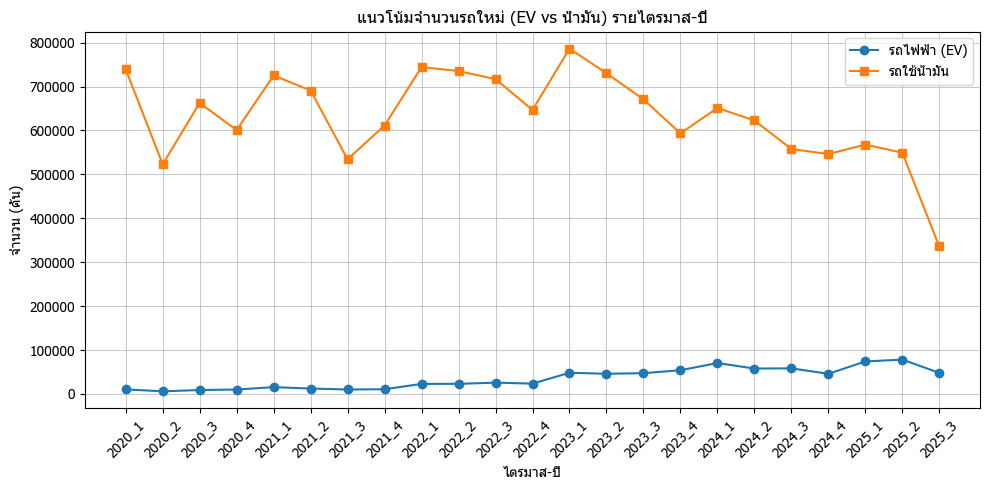

In [2]:
# -*- coding: utf-8 -*-
import pandas as pd
import matplotlib.pyplot as plt

FILE_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"

plt.rcParams["font.family"] = "Tahoma"

df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]

# กำหนด EV_total
if "sumev" in df.columns:
    df["EV_total"] = df["sumev"].fillna(0)
else:
    ev_cols = [c for c in df.columns if "ไฟฟ้า" in c]
    df["EV_total"] = df[ev_cols].fillna(0).sum(axis=1)

# กำหนด Fuel_total
if "sumfuel" in df.columns:
    df["Fuel_total"] = df["sumfuel"].fillna(0)
else:
    fuel_cols = [c for c in df.columns if "น้ำมัน" in c]
    if fuel_cols:
        df["Fuel_total"] = df[fuel_cols].fillna(0).sum(axis=1)
    else:
        df["Fuel_total"] = 0

# รวมตาม concat quarter year
agg = df.groupby("concat quarter year", as_index=False)[["EV_total","Fuel_total"]].sum()

# วาดกราฟ
plt.figure(figsize=(10,5))
plt.plot(agg["concat quarter year"], agg["EV_total"], marker="o", label="รถไฟฟ้า (EV)")
plt.plot(agg["concat quarter year"], agg["Fuel_total"], marker="s", label="รถใช้น้ำมัน")

plt.title("แนวโน้มจำนวนรถใหม่ (EV vs น้ำมัน) รายไตรมาส-ปี")
plt.xlabel("ไตรมาส-ปี")
plt.ylabel("จำนวน (คัน)")
plt.xticks(rotation=45)
plt.grid(True, linewidth=0.5)
plt.legend()
plt.tight_layout()
plt.show()


2) สัดส่วน EV (%) ต่อทั้งหมด — แยกตาม “ภูมิภาค” (ปีล่าสุด)

Insight: ภูมิภาคไหน “ยอมรับ EV” มากกว่ากัน (ดูเชิงสัดส่วน ไม่ใช่แค่จำนวน) ช่วยระบุ early-adopter area

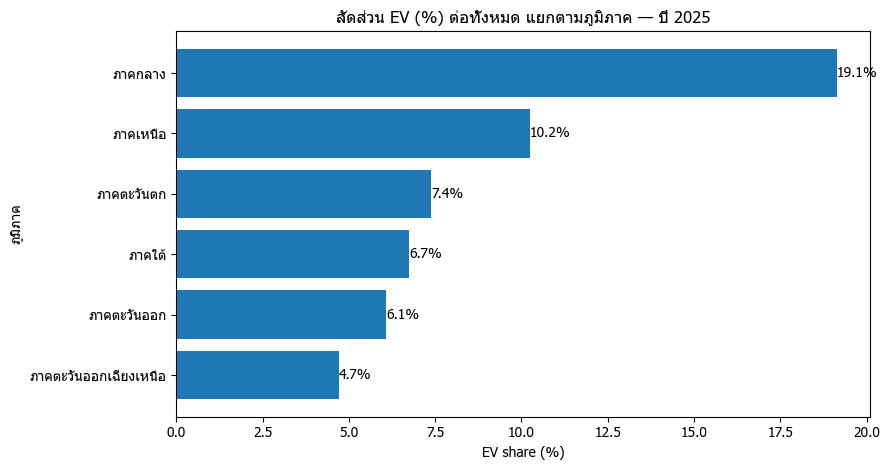

In [ ]:
# -*- coding: utf-8 -*-
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

FILE_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"

plt.rcParams["font.family"] = "Tahoma"

df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]

latest_year = int(df["year"].max())

# EV, TOTAL
if "sumev" in df.columns:
    df["EV_total"] = df["sumev"].fillna(0)
else:
    ev_cols = [c for c in df.columns if "ไฟฟ้า" in c]
    df["EV_total"] = df[ev_cols].fillna(0).sum(axis=1)

def _safe(c): return df[c].fillna(0) if c in df.columns else 0
df["TOTAL_all"] = _safe("sumfuel") + _safe("sumev") + _safe("sumother")

d = df[df["year"] == latest_year].copy()
region = d.groupby("REGION", as_index=False).agg(EV=("EV_total","sum"), TOT=("TOTAL_all","sum"))
region["EV_share_%"] = np.where(region["TOT"]>0, region["EV"]/region["TOT"]*100, 0)

region = region.sort_values("EV_share_%", ascending=False)

plt.figure(figsize=(9,4.8))
plt.barh(region["REGION"], region["EV_share_%"])
plt.gca().invert_yaxis()
plt.title(f"สัดส่วน EV (%) ต่อทั้งหมด แยกตามภูมิภาค — ปี {latest_year}")
plt.xlabel("EV share (%)")
plt.ylabel("ภูมิภาค")
for i,(y,v) in enumerate(zip(region["REGION"], region["EV_share_%"])):
    plt.text(v, i, f"{v:.1f}%", va="center", ha="left")
plt.tight_layout()
plt.show()


3) Top 15 จังหวัดที่มียอด EV สูงสุด (2025)

Insight: ระบุจังหวัด “ฐานตลาดใหญ่” เพื่อใช้วางกลยุทธ์ดีลเลอร์/สถานีชาร์จ/แคมเปญ

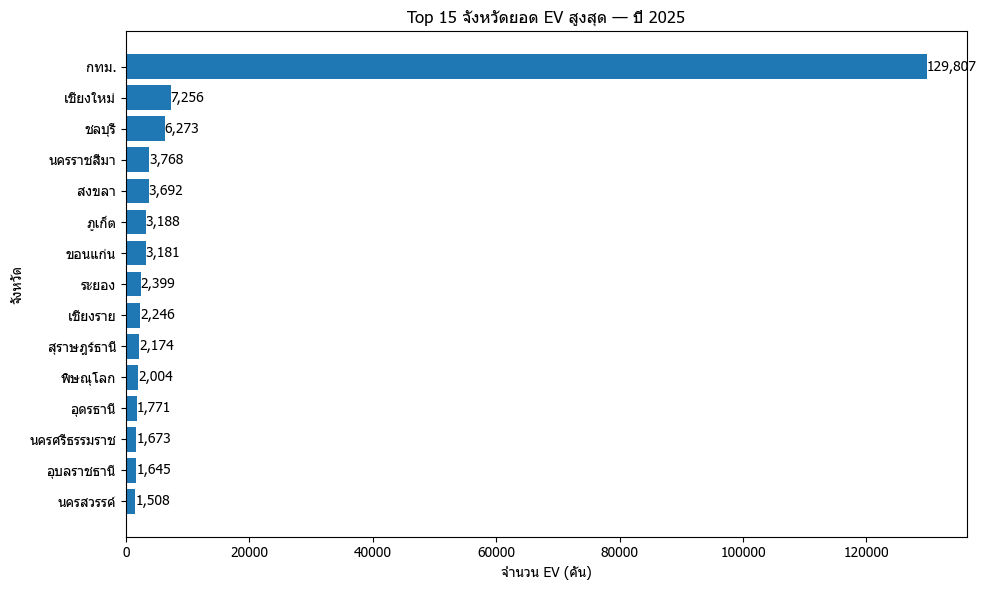

In [ ]:
# -*- coding: utf-8 -*-
import pandas as pd
import matplotlib.pyplot as plt

FILE_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"

plt.rcParams["font.family"] = "Tahoma"

df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]
latest_year = int(df["year"].max())

if "sumev" in df.columns:
    df["EV_total"] = df["sumev"].fillna(0)
else:
    ev_cols = [c for c in df.columns if "ไฟฟ้า" in c]
    df["EV_total"] = df[ev_cols].fillna(0).sum(axis=1)

d = df[df["year"] == latest_year].copy()
prov = d.groupby("Province", as_index=False)["EV_total"].sum()
top15 = prov.sort_values("EV_total", ascending=False).head(15)

plt.figure(figsize=(10,6))
plt.barh(top15["Province"], top15["EV_total"])
plt.gca().invert_yaxis()
plt.title(f"Top 15 จังหวัดยอด EV สูงสุด — ปี {latest_year}")
plt.xlabel("จำนวน EV (คัน)")
plt.ylabel("จังหวัด")
for i,(y,v) in enumerate(zip(top15["Province"], top15["EV_total"])):
    plt.text(v, i, f"{int(v):,}", va="center", ha="left")
plt.tight_layout()
plt.show()


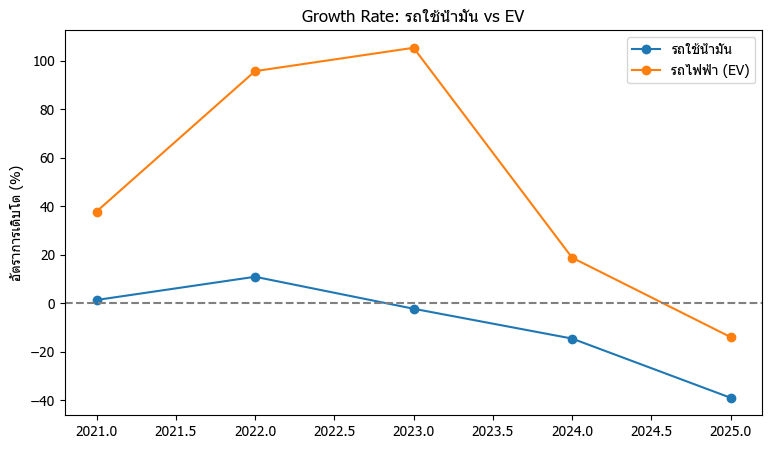

In [27]:
growth = yearly.set_index("year").pct_change()*100
plt.figure(figsize=(9,5))
plt.plot(growth.index, growth["Fuel"], marker="o", label="รถใช้น้ำมัน")
plt.plot(growth.index, growth["EV"], marker="o", label="รถไฟฟ้า (EV)")
plt.axhline(0, color="gray", linestyle="--")
plt.title("Growth Rate: รถใช้น้ำมัน vs EV")
plt.ylabel("อัตราการเติบโต (%)")
plt.legend()
plt.show()


In [ ]:
# -*- coding: utf-8 -*-
import pandas as pd
import plotly.express as px

FILE_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"

# โหลดข้อมูล
df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]

# เพิ่มหมวดหมู่
df["Fuel"]   = df["sumfuel"].fillna(0)   if "sumfuel" in df.columns else 0
df["EV"]     = df["sumev"].fillna(0)     if "sumev" in df.columns else 0
df["Hybrid"] = df["sumhybrid"].fillna(0) if "sumhybrid" in df.columns else 0

# ================= Aggregate รวมทุกปี =================
agg = df.groupby("Province", as_index=False)[["Fuel","EV","Hybrid"]].sum()

# ================= Plot Treemap (เลือก metric ที่จะดู) =================
metric = "EV"   # เลือก "Fuel", "EV", หรือ "Hybrid"

fig = px.treemap(
    agg,
    path=["Province"],
    values=metric,
    color=metric,
    color_continuous_scale="Blues",
    title=f"Treemap {metric} รายจังหวัด (รวมทุกปี)"
)
fig.show()


In [ ]:
# -*- coding: utf-8 -*-
import pandas as pd
import plotly.express as px

FILE_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"

# โหลดข้อมูล
df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]

# เพิ่มหมวดหมู่
df["Fuel"]   = df["sumfuel"].fillna(0)   if "sumfuel" in df.columns else 0
df["EV"]     = df["sumev"].fillna(0)     if "sumev" in df.columns else 0
df["Hybrid"] = df["sumhybrid"].fillna(0) if "sumhybrid" in df.columns else 0

# ================= ตัดกรุงเทพฯ ออก =================
bkk_alias = {"กรุงเทพมหานคร", "กทม.", "กรุงเทพฯ", "กรุงเทพ"}
df = df[~df["Province"].isin(bkk_alias)]

# ================= Aggregate รวมทุกปี =================
agg = df.groupby("Province", as_index=False)[["Fuel","EV","Hybrid"]].sum()

# ================= Plot Treemap (เลือก metric ที่จะดู) =================
metric = "EV"   # เลือก "Fuel", "EV", หรือ "Hybrid"

fig = px.treemap(
    agg,
    path=["Province"],
    values=metric,
    color=metric,
    color_continuous_scale="Blues",
    title=f"Treemap {metric} รายจังหวัด (รวมทุกปี, ไม่รวมกรุงเทพฯ)"
)
fig.show()


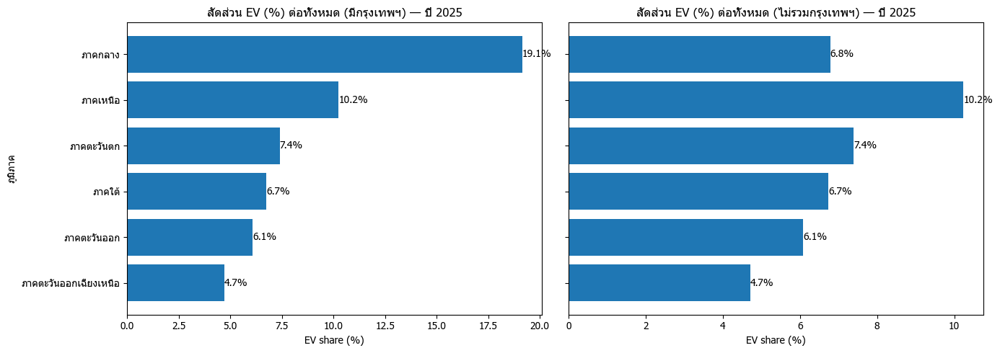

In [1]:
# -*- coding: utf-8 -*-
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

FILE_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"

plt.rcParams["font.family"] = "Tahoma"

# ---------- Load ----------
df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]
latest_year = int(df["year"].max())

# ---------- Build EV_total ----------
if "sumev" in df.columns:
    df["EV_total"] = df["sumev"].fillna(0)
else:
    ev_cols = [c for c in df.columns if "ไฟฟ้า" in c]
    df["EV_total"] = df[ev_cols].fillna(0).sum(axis=1)

# Total (for share)
def _safe(c): return df[c].fillna(0) if c in df.columns else 0
df["TOTAL_all"] = _safe("sumfuel") + _safe("sumev") + _safe("sumother")

# ใช้เฉพาะปีล่าสุด
base = df[df["year"] == latest_year].copy()

# ---------- Dataset A: มีกรุงเทพฯ ----------
with_bkk = (
    base.groupby("REGION", as_index=False)
        .agg(EV=("EV_total","sum"), TOT=("TOTAL_all","sum"))
)
with_bkk["EV_share_%"] = np.where(with_bkk["TOT"] > 0, with_bkk["EV"]/with_bkk["TOT"]*100, 0)

# กำหนดลำดับภูมิภาคจากชุด "มีกรุงเทพฯ"
with_bkk = with_bkk.sort_values("EV_share_%", ascending=False)
region_order = list(with_bkk["REGION"])

# ---------- Dataset B: ไม่มีกรุงเทพฯ ----------
bkk_alias = {"กรุงเทพมหานคร", "กทม.", "กรุงเทพฯ", "กรุงเทพ"}
without_bkk_base = base[~base["Province"].isin(bkk_alias)].copy()

without_bkk = (
    without_bkk_base.groupby("REGION", as_index=False)
        .agg(EV=("EV_total","sum"), TOT=("TOTAL_all","sum"))
)
without_bkk["EV_share_%"] = np.where(without_bkk["TOT"] > 0, without_bkk["EV"]/without_bkk["TOT"]*100, 0)

# รีออเดอร์ภูมิภาคให้ตรงกับฝั่ง "มีกรุงเทพฯ" เพื่อเทียบง่าย
with_bkk = with_bkk.set_index("REGION").loc[region_order].reset_index()
without_bkk = without_bkk.set_index("REGION").reindex(region_order).reset_index()

# ---------- Plot: Subplots ----------
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharey=True)

# ซ้าย: มีกรุงเทพฯ
axes[0].barh(with_bkk["REGION"], with_bkk["EV_share_%"])
axes[0].invert_yaxis()
axes[0].set_title(f"สัดส่วน EV (%) ต่อทั้งหมด (มีกรุงเทพฯ) — ปี {latest_year}")
axes[0].set_xlabel("EV share (%)")
axes[0].set_ylabel("ภูมิภาค")
for i, v in enumerate(with_bkk["EV_share_%"]):
    axes[0].text(v, i, f"{v:.1f}%", va="center", ha="left")

# ขวา: ไม่มีกรุงเทพฯ
axes[1].barh(without_bkk["REGION"], without_bkk["EV_share_%"])
axes[1].set_title(f"สัดส่วน EV (%) ต่อทั้งหมด (ไม่รวมกรุงเทพฯ) — ปี {latest_year}")
axes[1].set_xlabel("EV share (%)")
for i, v in enumerate(without_bkk["EV_share_%"]):
    axes[1].text(v, i, f"{v:.1f}%", va="center", ha="left")

plt.tight_layout()
plt.show()


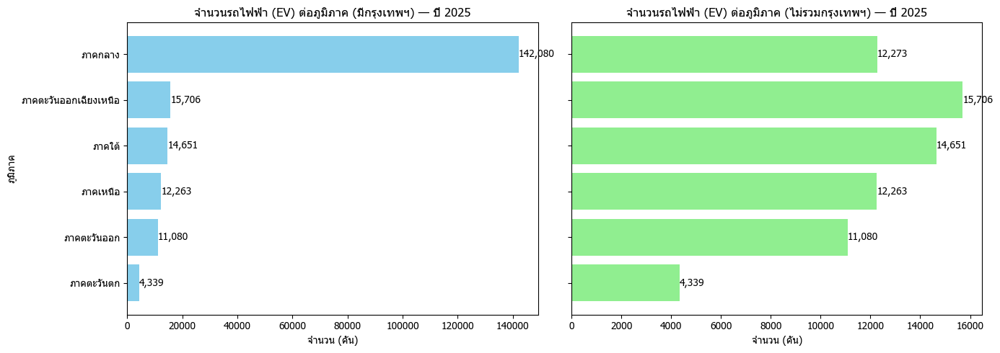

In [2]:
# -*- coding: utf-8 -*-
import pandas as pd
import matplotlib.pyplot as plt

FILE_PATH = r"..\Python Project\File Store\2020-2025 console.xlsx"
SHEET_NAME = "RAW"

plt.rcParams["font.family"] = "Tahoma"

# ---------- Load ----------
df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]
latest_year = int(df["year"].max())

# ---------- Build EV_total ----------
if "sumev" in df.columns:
    df["EV_total"] = df["sumev"].fillna(0)
else:
    ev_cols = [c for c in df.columns if "ไฟฟ้า" in c]
    df["EV_total"] = df[ev_cols].fillna(0).sum(axis=1)

# ใช้เฉพาะปีล่าสุด
base = df[df["year"] == latest_year].copy()

# ---------- Dataset A: มีกรุงเทพฯ ----------
with_bkk = (
    base.groupby("REGION", as_index=False)
        .agg(EV=("EV_total","sum"))
)
with_bkk = with_bkk.sort_values("EV", ascending=False)
region_order = list(with_bkk["REGION"])

# ---------- Dataset B: ไม่มีกรุงเทพฯ ----------
bkk_alias = {"กรุงเทพมหานคร", "กทม.", "กรุงเทพฯ", "กรุงเทพ"}
without_bkk_base = base[~base["Province"].isin(bkk_alias)].copy()

without_bkk = (
    without_bkk_base.groupby("REGION", as_index=False)
        .agg(EV=("EV_total","sum"))
)
without_bkk = without_bkk.set_index("REGION").reindex(region_order).reset_index()

# ---------- Plot: Subplots ----------
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharey=True)

# ซ้าย: มีกรุงเทพฯ
axes[0].barh(with_bkk["REGION"], with_bkk["EV"], color="skyblue")
axes[0].invert_yaxis()
axes[0].set_title(f"จำนวนรถไฟฟ้า (EV) ต่อภูมิภาค (มีกรุงเทพฯ) — ปี {latest_year}")
axes[0].set_xlabel("จำนวน (คัน)")
axes[0].set_ylabel("ภูมิภาค")
for i, v in enumerate(with_bkk["EV"]):
    axes[0].text(v, i, f"{int(v):,}", va="center", ha="left")

# ขวา: ไม่มีกรุงเทพฯ
axes[1].barh(without_bkk["REGION"], without_bkk["EV"], color="lightgreen")
axes[1].set_title(f"จำนวนรถไฟฟ้า (EV) ต่อภูมิภาค (ไม่รวมกรุงเทพฯ) — ปี {latest_year}")
axes[1].set_xlabel("จำนวน (คัน)")
for i, v in enumerate(without_bkk["EV"]):
    axes[1].text(v if not pd.isna(v) else 0, i, f"{int(v) if not pd.isna(v) else 0:,}", va="center", ha="left")

plt.tight_layout()
plt.show()


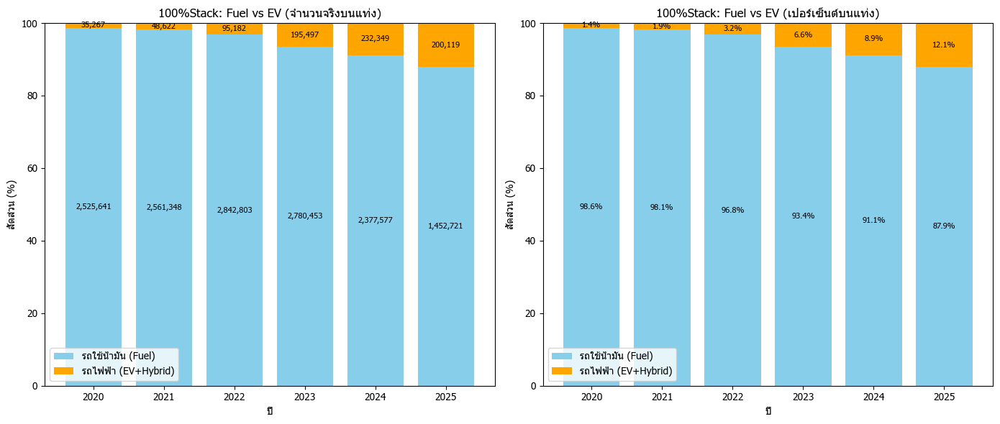

In [9]:
# -*- coding: utf-8 -*-
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# ---------------- PATH ----------------
FILE_PATH = Path(r"..\Python Project\File Store\2020-2025 console.xlsx")
SHEET_NAME = "RAW"

plt.rcParams["font.family"] = "Tahoma"

# ---------------- LOAD DATA ----------------
df = pd.read_excel(FILE_PATH, sheet_name=SHEET_NAME)
df.columns = [str(c).strip() for c in df.columns]

# ---------------- FUEL TOTAL ----------------
if "sumfuel" in df.columns:
    df["Fuel_total"] = df["sumfuel"].fillna(0)
else:
    fuel_cols = [c for c in df.columns if "น้ำมัน" in c]
    df["Fuel_total"] = df[fuel_cols].fillna(0).sum(axis=1) if fuel_cols else 0

# ---------------- EV TOTAL (รวม Hybrid) ----------------
df["EV_total"] = df["sumev"].fillna(0) if "sumev" in df.columns else 0
if "sumhybrid" in df.columns:
    df["EV_total"] += df["sumhybrid"].fillna(0)

# ---------------- AGGREGATE ----------------
agg = df.groupby("year", as_index=False)[["Fuel_total","EV_total"]].sum()

# คำนวณสัดส่วน (%)
agg["Fuel_share"] = agg["Fuel_total"] / (agg["Fuel_total"] + agg["EV_total"]) * 100
agg["EV_share"]   = agg["EV_total"] / (agg["Fuel_total"] + agg["EV_total"]) * 100

# ---------------- PLOT ----------------
fig, axes = plt.subplots(1, 2, figsize=(14,6))

# --- Subplot ซ้าย: 100% Stacked Bar (โชว์จำนวนจริงบนแท่ง) ---
axes[0].bar(agg["year"], agg["Fuel_share"], label="รถใช้น้ำมัน (Fuel)", color="skyblue")
axes[0].bar(agg["year"], agg["EV_share"], bottom=agg["Fuel_share"], label="รถไฟฟ้า (EV+Hybrid)", color="orange")
axes[0].set_title("100%Stack: Fuel vs EV (จำนวนจริงบนแท่ง)")
axes[0].set_xlabel("ปี")
axes[0].set_ylabel("สัดส่วน (%)")
axes[0].set_ylim(0, 100)
axes[0].legend()

# ใส่จำนวนจริง (Fuel, EV) บนแท่ง
for i, (fuel, ev) in enumerate(zip(agg["Fuel_total"], agg["EV_total"])):
    axes[0].text(agg["year"].iloc[i], agg["Fuel_share"].iloc[i]/2,
                 f"{int(fuel):,}", ha="center", va="center", fontsize=8, color="black")
    axes[0].text(agg["year"].iloc[i], agg["Fuel_share"].iloc[i] + agg["EV_share"].iloc[i]/2,
                 f"{int(ev):,}", ha="center", va="center", fontsize=8, color="black")

# --- Subplot ขวา: 100% Stacked Bar (โชว์ % บนแท่ง) ---
axes[1].bar(agg["year"], agg["Fuel_share"], label="รถใช้น้ำมัน (Fuel)", color="skyblue")
axes[1].bar(agg["year"], agg["EV_share"], bottom=agg["Fuel_share"], label="รถไฟฟ้า (EV+Hybrid)", color="orange")
axes[1].set_title("100%Stack: Fuel vs EV (เปอร์เซ็นต์บนแท่ง)")
axes[1].set_xlabel("ปี")
axes[1].set_ylabel("สัดส่วน (%)")
axes[1].set_ylim(0, 100)
axes[1].legend()

# ใส่เปอร์เซ็นต์บนแท่ง
for i, (fuel, ev) in enumerate(zip(agg["Fuel_share"], agg["EV_share"])):
    axes[1].text(agg["year"].iloc[i], fuel/2,
                 f"{fuel:.1f}%", ha="center", va="center", fontsize=8, color="black")
    axes[1].text(agg["year"].iloc[i], fuel + ev/2,
                 f"{ev:.1f}%", ha="center", va="center", fontsize=8, color="black")

plt.tight_layout()
plt.show()
